In [1]:
import pretty_midi
import IPython
MIDI_PATH = "data/Lifelight.mid"
midi_data = pretty_midi.PrettyMIDI(MIDI_PATH)

print("Tempo estimate: ", midi_data.estimate_tempo())
# Compute the relative amount of each semitone across the entire song, a proxy for key
total_velocity = sum(sum(midi_data.get_chroma()))
print("Semitone amount per key: ", [sum(semitone)/total_velocity for semitone in midi_data.get_chroma()])

# Synthesize the resulting MIDI data using sine waves
fs = 44100
audio_data = midi_data.synthesize()
IPython.display.Audio(audio_data, rate=fs)

Tempo estimate:  181.0287524573241
Semitone amount per key:  [0.05390078439686241, 0.013249947000211999, 0.17505829976680093, 0.04446682213271147, 0.10022259910960356, 0.1351494594021624, 0.02877888488446046, 0.2080241679033284, 0.037894848420606315, 0.11442654229383083, 0.05162179351282595, 0.03720585117659529]


(36, 7200)


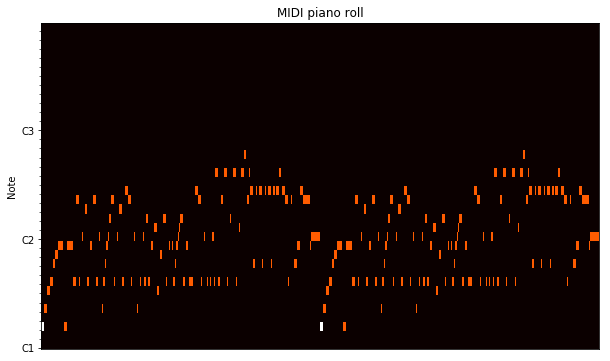

In [11]:
import matplotlib.pyplot as plt
import librosa
import librosa.display

# Retrieve piano roll of the MIDI file
piano_roll = midi_data.get_piano_roll()
# Use 7 octaves starting from C4-C7
piano_roll = piano_roll[(12*4):(12*7)]

plt.figure(figsize=(10, 6))
librosa.display.specshow(piano_roll, y_axis='cqt_note', cmap=plt.cm.hot)
plt.title('MIDI piano roll')
print(np.array(piano_roll).shape)

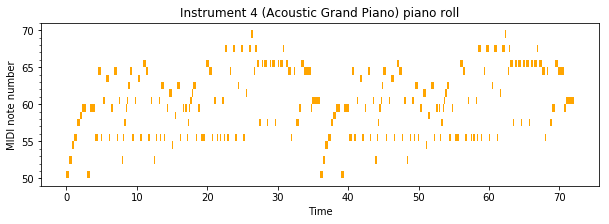

In [8]:
import mir_eval
import mir_eval.display
import numpy as np
# pretty_midi also provides direct access to the pitch and start/end time of each note
intervals = np.array([[note.start, note.end] for note in midi_data.instruments[-1].notes])
notes = np.array([note.pitch for note in midi_data.instruments[-1].notes])
program_name = pretty_midi.program_to_instrument_name(midi_data.instruments[-1].program)
plt.figure(figsize=(10, 3))
mir_eval.display.piano_roll(intervals, midi=notes, facecolor='orange')
plt.title('Instrument 4 ({}) piano roll'.format(program_name))
plt.xlabel('Time')
plt.ylabel('MIDI note number');